In questo esempio testo i modelli di encoding basati su InfoNCE.
Inizio con un dataset sintetico con una singola variabile latente (binaria) che egenera dati di dimensione 64. Proseguo con un dataset sintetico con tre variabili latenti binarie e mostro come gestire i dati multi-label. Infine lavoro con il dataset BCI ma anch'esso con tre label, ma dividendolo in finestre di 250 punti in modo da poter lavorare non solo sui trial, ma anche nel tempo. Le label che scelgo sono:
- Label CUE, che corrisponde alla label del dataset oppure essere indefinita (se la finestra considerata è precedente all'istante t = 0)
- Label TIME, che codifica semplicemente l'istante di tempo corrispondente a quella finestra (può essere scelto quello centrale o quello finale)
- Label CONDITION, che indica se la data finestra si trova nella fase di fixation, nella fase cue o nella fase di motion imagery.

Lavoro sia con un modello InfoNCE come CEBRA, che sampla esempi positivi per ogni esempio di riferimento con una distribuzione di probabilità data, sia con un modello creato da me in cui il sampling è sempre uniforme, non c'è distinzione tra esempio positivi e negativi, ma viene introdotta una funzione di "distanza tra label" che svolge lo stesso compito.

In [2]:
%reload_ext autoreload
%autoreload 2
from torch.utils.data import DataLoader
from datasets import DatasetEEG, TrialEEG
import torch
import numpy as np
from torch import nn

from sklearn.svm import SVC
from utils import plot_training_metrics, count_model_parameters, train_model
from dataset_filters import normalize_signals
from matplotlib import pyplot as plt

from plots import plot_latent_trajectories_3d


## Dataset sintetico single-label

Parto da una variabile latente binaria che genera i dati osservati come funzioni sinusoidali + rumore. Fitto poi un encoder InfoNCE con tre variabili latenti e osservo come vengono separati i samples

In [2]:
trials_dummy = []
num_samples = 2000
data_dim = 64


# Genero i trial
for i in range(num_samples):
        
    label = np.random.randint(0,2)

    if label == 0:
        x = np.sin(np.linspace(0, 2 * np.pi, data_dim))
    else:
        x = np.cos(np.linspace(0, 2 * np.pi, data_dim))

    noise = np.random.randn(64)
    for k in range(4): 
        for l in range(1,data_dim-1):
            noise[l] = (noise[l] + noise[l-1] + noise[l+1])/3

    x += noise * 0.7

    x = x.reshape((data_dim, 1))
    x = x - np.mean(x)

    trial = TrialEEG(x, label, timepoints=np.linspace(0,1,data_dim))
    trials_dummy.append(trial)

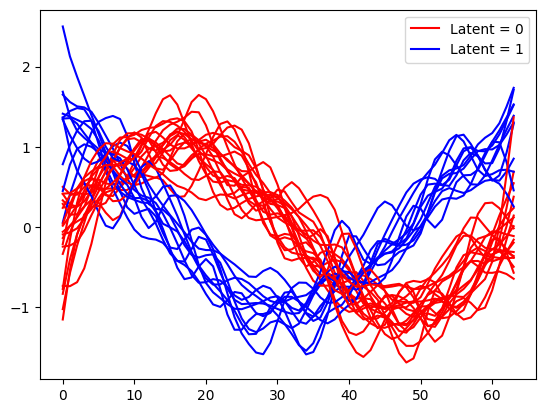

In [3]:
# Visualizzo qualche sample
plt.figure()
for i in range(0, 30):

    label = trials_dummy[i].label

    if label == 0: color = 'r'
    else: color = 'b'

    plt.plot(trials_dummy[i].eeg_signals, color=color)
plt.legend(['Latent = 0','Latent = 1'])

Il dataset EEG viene generato come in tutti gli altri esempi e lo stesso vale per il dataset EEGTorch

In [4]:
dataset_dummy = DatasetEEG(trials_dummy)
print(dataset_dummy)

from datasets import DatasetEEGTorch
dataset_dummy_pytorch = DatasetEEGTorch(dataset_dummy)

# Se è presente la GPU sfrutto quella e sposto i dataset
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

dataset_dummy_pytorch.to_device(device)



num_trials               :  2000
num_channels             :  64
num_timepoints           :  1
labels_type              :  single_label
labels_format            :  int

cuda


/home/nuzzi/Projects/EEG_Pipeline/EEG-ANN-Pipeline/.venv/lib/python3.10/site-packages/torch/cuda/__init__.py:654: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")


C'è però una differenza sostanziale per il dataloader, che invece di essere la classe DataLoader di pytorch è un mio dataloader custom. Ciò perché i batch non devono essere selezionati nella maniera classica ma in un modo particolare: vengono prima samplati batch_size punti uniformemente nel dataset, che fungono da riferimenti; poi vengono samplati altrettanti punti uniformemente per fungere da esempi negativi e infine, per ognuno dei sample tra quelli di riferimento, viene samplato un corrispondente esempio positivo che abbia la stessa label.
Per via di questa procedura, il dataset non viene scomposto in batch disgiunti e non c'è più un concetto di "epoche", quindi si deve fornire un parametro aggiuntivo "batches_per_epoch" che indica quante volti batch si vogliono processare per ogni epoca fittizia. 

Inoltre bisogna specificare come samplare gli esempi positivi. Ciò viene fatto tramite il parametro "samplers" del dataloader. Attualmente sono implementati un solo tipo di sampler discreto e uno continuo.

In questo caso con ho una sola label discreta.

In [5]:
from datasets import DataLoaderContrastive, SamplerDiscrete

sampler = SamplerDiscrete(dataset_dummy_pytorch.labels)
dataloader = DataLoaderContrastive(dataset_dummy_pytorch, samplers=sampler, batch_size=32, batches_per_epoch=10)


Il modello base, basato su InfoNCE e simile a quello di CEBRA, si chiama "EncoderInfoNCE" e richiede che venga passato il modello di rete neurale per generare le rappresentazioni latenti. E' inoltre possibile fornire il parametro "train_temperature" se si vuole che la temperatura (con cui vengono pesate le similarità) venga appresa dal modello o sia fissa.

La loss è scomposta in due pezzi, la "uniformity" è il termine corrispondente agli esempi negativi, mentre la "alignement" è il termine corrispondente agli esempi positivi

In [6]:
# Ora creo il modello InfoNCE modificato con pesi e multilabel
from models.EncoderInfoNCE import EncoderInfoNCE

latent_dim = 3
num_channels = 22

# L'input è di tipo (batch_size, 1, num_channels, num_timepoints)
# Lo processo in maniera molto semplice facendo una convoluzione temporale
# e poi unendo i vari canali tra loro
layers = nn.Sequential(
        nn.Flatten(),
        nn.Linear(data_dim, 32),
        nn.LeakyReLU(),
        nn.BatchNorm1d(32),
        nn.Dropout(0.25),
        nn.Linear(32, 32),
        nn.LeakyReLU(),
        nn.BatchNorm1d(32),
        nn.Dropout(0.25),
        nn.Linear(32, latent_dim)
)


model = EncoderInfoNCE(layers=layers, temperature=0.1, train_temperature=False)
model.to(device)
print(f'Il modello ha {count_model_parameters(model)} parametri')

Il modello ha 3363 parametri


100%|██████████| 50/50 [00:07<00:00,  7.06it/s, alignement=0.00454, uniformity=0.0819, loss=0.0864]


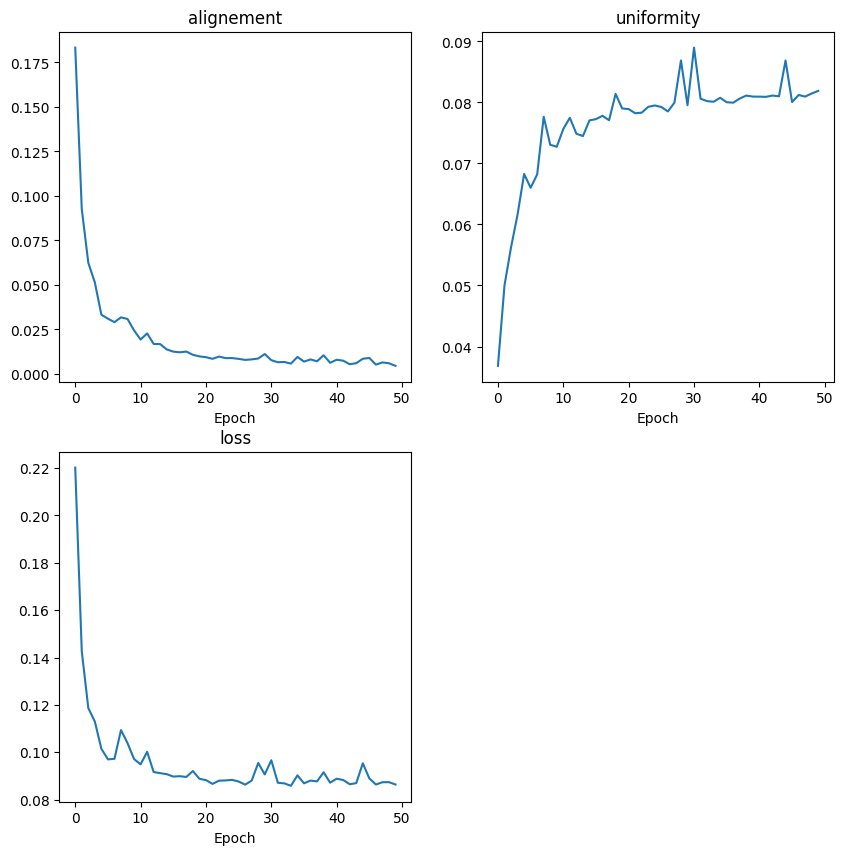

In [7]:
# Ottimizzatore
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

# Faccio il training e zottengo la storia di tutte le metriche
metrics = train_model(model, optimizer, dataloader, epochs=50)

# Plot risultati del training
plot_training_metrics(metrics)

Visualizzo, su una sfera 3d, le rappresentazioni latenti. Correttamente i samples vengono divisi in due cluster disgiunti, che coloro in funzione della corrispondente label (variabile latente corretta con cui ho generato i dati)

In [8]:
from plots import plot_latents_3d
from plotly import graph_objects as go

model.eval()

x = dataset_dummy_pytorch.eeg_signals
labels = dataset_dummy_pytorch.labels.cpu().numpy()
z = model(x).detach().cpu().numpy()

fig = plot_latents_3d(z, labels, markersize=3, alpha=0.1)
fig.show()



## Dataset sintetico multi-label

In questo dataset ho 3 variabili latenti binarie con quali genero dati di dimensionalità 64

In [9]:
trials_dummy = []
num_samples = 2000
data_dim = 64

A = np.random.randn(64, 3)
B = np.random.randn(64)

# Smusso
for k in range(2):
    for i in range(data_dim):
        a = 0
        b = 0
        n = 0
        for j in range(-5,5):
            if i + j < data_dim and i + j >= 0:
                a += A[i+j,:]
                b += B[i+j]
                n += 1
        a /= n
        b /= n

        A[i,:] = a
        B[i] = b
        
for i in range(num_samples):

    label_1 = np.random.randint(0,2)
    label_2 = np.random.randint(0,2)
    label_3 = np.random.randint(0,2)

    x = A @ np.array([label_1, label_2, label_3]) + B
    x = x.reshape((data_dim, 1))
    x += np.random.randn(*x.shape) * 0.03
    x = x - np.mean(x)


    labels = {'label_1': label_1, 'label_2': label_2, 'label_3': label_3}

    
    trial = TrialEEG(x, labels, timepoints=np.linspace(0,1,data_dim))
    trials_dummy.append(trial)

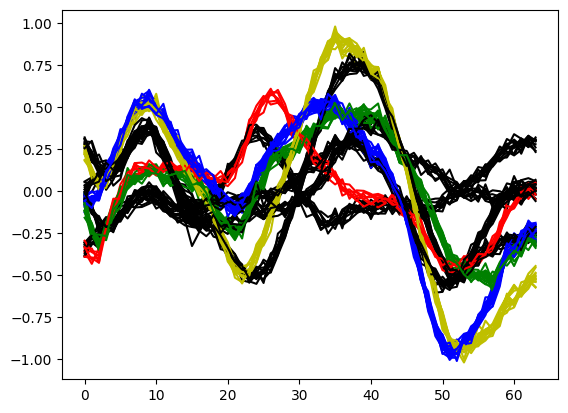

In [10]:
# Visualizzo qualche sample
plt.figure()
for i in range(0, 100):

    l1 = trials_dummy[i].label['label_1']
    l2 = trials_dummy[i].label['label_2']
    l3 = trials_dummy[i].label['label_3']

    color = 'k'

    if l1 == 1:
        if l2 == 0 and l3 == 0: color = 'r'
        if l2 == 0 and l3 == 1: color = 'b'
        if l2 == 1 and l3 == 0: color = 'g'
        if l2 == 1 and l3 == 1: color = 'y'

    plt.plot(trials_dummy[i].eeg_signals, color=color)

In [11]:
dataset_dummy = DatasetEEG(trials_dummy)
print(dataset_dummy)


from datasets import DatasetEEGTorch
dataset_dummy_pytorch = DatasetEEGTorch(dataset_dummy)

# Se è presente la GPU sfrutto quella e sposto i dataset
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

dataset_dummy_pytorch.to_device(device)



num_trials               :  2000
num_channels             :  64
num_timepoints           :  1
labels_type              :  multi_label
labels_format            :  {'label_1': 'int', 'label_2': 'int', 'label_3': 'int'}

cuda


In [12]:
from datasets import DataLoaderContrastive, SamplerDiscrete

sampler_1 = SamplerDiscrete(dataset_dummy_pytorch.labels['label_1'])
sampler_2 = SamplerDiscrete(dataset_dummy_pytorch.labels['label_2'])
sampler_3 = SamplerDiscrete(dataset_dummy_pytorch.labels['label_3'])

samplers = {'label_1': sampler_1, 'label_2': sampler_2, 'label_3': sampler_3}
dataloader = DataLoaderContrastive(dataset_dummy_pytorch, samplers=samplers, batch_size=32, batches_per_epoch=10)


In [13]:
# Ora creo il modello InfoNCE modificato con pesi e multilabel
from models.EncoderInfoNCE import EncoderInfoNCE

latent_dim = 3
num_channels = 22

layers = nn.Sequential(
        nn.Flatten(),
        nn.Linear(data_dim, 32),
        nn.LeakyReLU(),
        nn.BatchNorm1d(32),
        nn.Dropout(0.25),
        nn.Linear(32, 32),
        nn.LeakyReLU(),
        nn.BatchNorm1d(32),
        nn.Dropout(0.25),
        nn.Linear(32, latent_dim)
)


model = EncoderInfoNCE(layers=layers, temperature=1)
model.to(device)
print(f'Il modello ha {count_model_parameters(model)} parametri')

Il modello ha 3363 parametri


  0%|          | 0/50 [00:00<?, ?it/s]

100%|██████████| 50/50 [00:12<00:00,  3.88it/s, alignement=0.0594, uniformity=0.251, loss=0.31] 


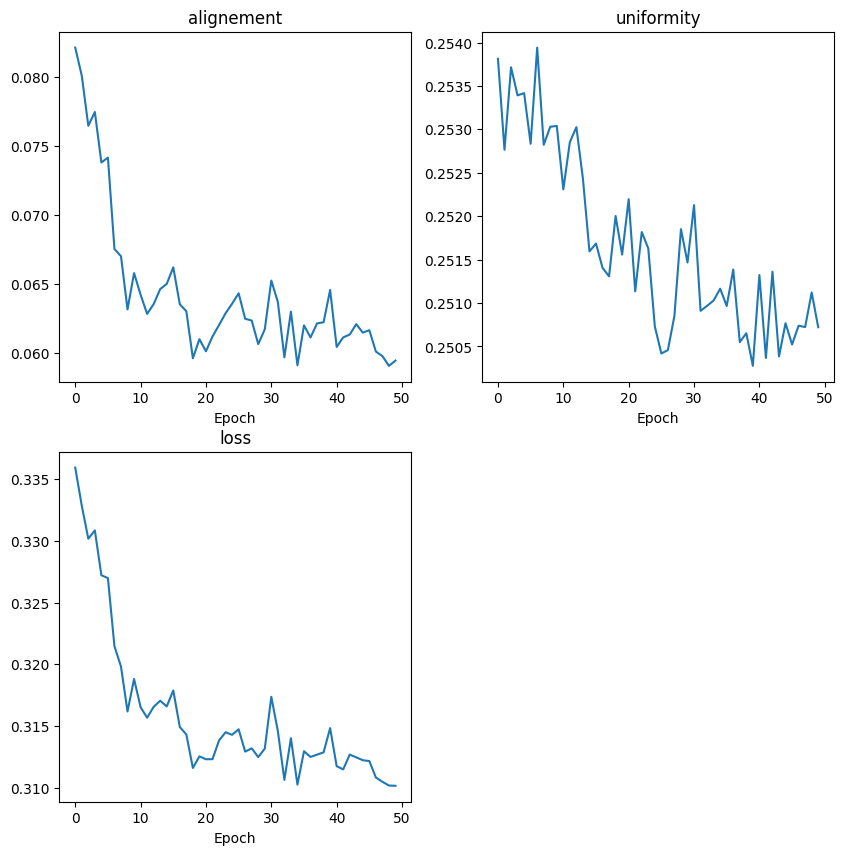

In [14]:
# Ottimizzatore
optimizer = torch.optim.Adam(model.parameters(), lr=3e-4)

# Faccio il training e zottengo la storia di tutte le metriche
metrics = train_model(model, optimizer, dataloader, epochs=50)

# Plot risultati del training
plot_training_metrics(metrics)

Visualizzando le rappresentazioni latenti apprese esse si dispongono sui vertici di un cubo inscritto nella circonferenza unitaria, quindi nella maniera che meglio rappresenta il fatto che i dati sono generati a partire da tre variabili latenti binarie. Nella visualizzazione coloro ogni sample in funzione di una sola delle tre label

In [15]:
from plots import plot_latents_3d

model.eval()

x = dataset_dummy_pytorch.eeg_signals
labels = dataset_dummy_pytorch.labels['label_3'].cpu().numpy()
z = model(x).detach().cpu().numpy()

fig = plot_latents_3d(z, labels, markersize=3, alpha=0.1)
fig.show()



## Dataset EEG - Modello InfoNCE

Modifico il dataset BCI in modo che abbia le seguenti caratteristiche:
- Finestra mobile larga 250 punti, con shift temporali di 10 punti, per ottenenere più samples a partire dallo stesso trial
- Creazione di più labels diverse oltre a quella base del dataset, che chiamo CUE. Per ogni finestra indico anche la condizione (se è una finestra nella fase fixations, cue o compito di motion imagery) e uso anche l'istante di tempo come una label. 

Per assegnare le label a ogni finestra considero l'ultimo istante di tempo in essa. Inoltre aggiungo un ulteriore valore alla label CUE, per considerare il caso in cui lo stimolo non è ancora comparso (i secondi prima dell'istante 0)

In [12]:
dataset = DatasetEEG.load('DatasetBCI/Dataset_03_Training_NoArtifacts.dataset')
normalize_signals(dataset)

# Lo shift è dato in punti, mentre tutti gli altri parametri
# sono dati come tempi in secondi
fs = 250
dt = 1/fs
shift = 10       # Shift temporale (in punti) tra finestre
window = 250      # Larghezza (in punti) della finestra

trials_new = []

# Ciclo sui trial
for n, trial in enumerate(dataset.trials):

    signals = trial.eeg_signals
    label = trial.label
    times = trial.timepoints
    
    # Creo la prima finestra
    ind_center = window // 2
    ind_min = ind_center - window // 2
    ind_max = ind_min + window

    # Ciclo fino a quando non ho finito lo spazio nel trial
    while ind_max < len(times):

        t = times[ind_max]
        
        # In base a "t" devo capire in che condizione mi trovo
        if t >= -2 and t < 0:
            condition = 'Fixation'
            label_cue = 4
        elif t >= 0 and t < 1:
            condition = 'Cue'
            label_cue = label
        elif t >= 1 and t < 4:
            condition = 'Imagery'
            label_cue = label
        else:
            condition = None

        # Se sono in una condizione accettabile costruisco il sample
        if condition is not None:
            x = signals[:, ind_min:ind_max]
            label_full = {'Cue': label_cue, 'Time': t, 'Condition': condition}
            trial_new = TrialEEG(x, label_full, times[ind_min:ind_max])
            trials_new.append(trial_new)

        ind_center += shift
        ind_min = ind_center - window // 2
        ind_max = ind_min + window



In [13]:
dataset_windows = DatasetEEG(trials_new, info=dataset.info)
print(dataset_windows)


num_trials               :  33750
num_channels             :  22
num_timepoints           :  250
labels_type              :  multi_label
labels_format            :  {'Cue': 'int', 'Time': 'float', 'Condition': 'string'}
subject                  :  3
fs                       :  250



In [14]:
from datasets import DatasetEEGTorch
dataset_pytorch = DatasetEEGTorch(dataset_windows)

# Se è presente la GPU sfrutto quella e sposto i dataset
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

dataset_pytorch.to_device(device)



cuda


In questo caso il sampler per i tempi lo prendo gaussiano, perché la label relativa è continua e non discreta.

In [15]:
from datasets import DataLoaderContrastive, SamplerContinuousGaussian

sampler_1 = SamplerDiscrete(dataset_pytorch.labels['Cue'])
sampler_2 = SamplerContinuousGaussian(dataset_pytorch.labels['Time'], std=0.3)
sampler_3 = SamplerDiscrete(dataset_pytorch.labels['Condition'])

samplers = {'Cue': sampler_1, 'Time': sampler_2, 'Condition': sampler_3}
dataloader = DataLoaderContrastive(dataset_pytorch, samplers=samplers, batch_size=512, batches_per_epoch=10)


In [16]:
from models.EncoderInfoNCE import EncoderInfoNCE

latent_dim = 3
num_channels = 22
F1, F2 = 16, 32

# L'input è di tipo (batch_size, 1, num_channels, num_timepoints)
# Lo processo in maniera molto semplice facendo una convoluzione temporale
# e poi unendo i vari canali tra loro
layers =  nn.Sequential(
            nn.Conv2d(1, F1, kernel_size=(1, 64), padding='same', bias=False), # First temporal convolution
            nn.BatchNorm2d(F1),
            nn.Conv2d(F1, F2, kernel_size=(num_channels, 1), bias=False, groups=F1), # Depthwise convolution
            nn.BatchNorm2d(F2),
            nn.ELU(),
            nn.AvgPool2d(kernel_size=(1,4)),
            nn.Dropout(0.5),
            nn.Conv2d(F2, F2, kernel_size=(1, 16), bias=False, groups=F2),  # Separable = Depthwise + Pointwise
            nn.Conv2d(F2, F2, kernel_size=(1, 1), bias=False),              # Separable = Depthwise + Pointwise
            nn.BatchNorm2d(F2),
            nn.ELU(),
            nn.AvgPool2d(kernel_size=(1,8)),
            nn.Dropout(0.5),
            nn.Flatten(),
            nn.LazyLinear(latent_dim)
        )


model = EncoderInfoNCE(layers=layers, temperature=1, train_temperature=True)
model.to(device)
print(f'Il modello ha {count_model_parameters(model)} parametri')



Il modello ha 3425 parametri


In [12]:
# Ottimizzatore
optimizer = torch.optim.Adam(model.parameters(), lr=3e-4)

# Faccio il training e zottengo la storia di tutte le metriche
metrics = train_model(model, optimizer, dataloader, epochs=200)

# Plot risultati del training
plot_training_metrics(metrics)

  0%|          | 0/200 [00:00<?, ?it/s]/home/nuzzi/Projects/EEG_Pipeline/EEG-ANN-Pipeline/.venv/lib/python3.10/site-packages/torch/nn/modules/conv.py:454: UserWarning: Using padding='same' with even kernel lengths and odd dilation may require a zero-padded copy of the input be created (Triggered internally at ../aten/src/ATen/native/Convolution.cpp:1031.)
  return F.conv2d(input, weight, bias, self.stride,
 48%|████▊     | 96/200 [06:07<06:37,  3.83s/it, alignement=0.00229, uniformity=0.0328, loss=0.0351]


KeyboardInterrupt: 

Nel visualizzare gli emvedding in questo caso ciclo a mano (a batch di 512) sull'intero dataseto, non potendo usare il dataloader in quanto, come già spiegato, esso non cicla sul dataset ma sampla i batch uniformemente su di esso

In [14]:
model.eval()

z = np.zeros((0, latent_dim))
labels_cue = np.zeros(0)
labels_time = np.zeros(0)
labels_condition = np.zeros(0)

for i in range(0,dataset_pytorch.num_trials,512):
    x = dataset_pytorch.eeg_signals[i:i+512,:,:,:]
    l_cue = dataset_pytorch.labels['Cue'][i:i+512]
    l_time = dataset_pytorch.labels['Time'][i:i+512]
    l_condtion = dataset_pytorch.labels['Condition'][i:i+512]

    f_x = model.forward(x)  
    z = np.concatenate((z, f_x.cpu().detach().numpy()), axis=0)
    labels_cue = np.concatenate((labels_cue, l_cue.cpu().detach().numpy()))
    labels_time = np.concatenate((labels_time, l_time.cpu().detach().numpy()))
    labels_condition = np.concatenate((labels_condition, l_condtion.cpu().detach().numpy()))

from plots import plot_latents_3d

fig = plot_latents_3d(z, labels_cue, markersize=0.5, alpha=1, figsize=(7,7))
fig.show()

fig = plot_latents_3d(z, labels_condition, markersize=0.5, alpha=1, figsize=(7,7))
fig.show()

fig = plot_latents_3d(z, labels_time, discrete=False, show_legend=False, markersize=0.5, alpha=1, figsize=(7,7))
fig.show()




Calcolo le accuratezze nella classificazione (per CUE e per CONDITION) a partire dalle rappresentazioni latenti con una SVC

In [25]:
# Inizializzo il modello SVC
from sklearn.svm import SVC

model_svc = SVC()

# Fit del modello e calcolo accuratezza
model_svc.fit(z, labels_cue)
accuracy = model_svc.score(z, labels_cue)
print(f'Training accuracy for CUE = {accuracy*100:.2f}%')

model_svc.fit(z, labels_condition)
accuracy = model_svc.score(z, labels_condition)
print(f'Training accuracy for Condition = {accuracy*100:.2f}%')


Training accuracy for CUE = 39.38%
Training accuracy for Condition = 86.57%


## Dataset EEG - Modello Constrastive mio

In questo caso la funzione di loss è una versione modificata di InfoNCE in modo da non separare tra sample positivi e negativi ma pesare la distanza tra label (e definirne quindi una similarità)

Il mio modello funziona senza bisogno di un dataloader specifico (come nel caso precedente). Ma, a differenza del precedente, bisogna specificare come calcolare la distanza tra ogni coppia di label. Per far ciò si usa la classe 

In [17]:
dataloader = DataLoader(dataset_pytorch, batch_size=512, shuffle=True)


# Definisco un oggetto di tipo LabelsDistance a cui dico come gestire ogni diverso tipo di label
from datasets import LabelsDistance


def cue_distance(l1, l2):
    return (l1 == l2) * 1

def time_distance(l1, l2):
    return torch.exp(-3 * (l1 - l2)**2 )

# Condition
def condition_distance(l1, l2):
    return (l1 == l2) * 0.5


labels_distance = LabelsDistance(labels_distance_functions=
                                 {
                                     'Cue': cue_distance,
                                     'Time': time_distance,
                                     'Condition': condition_distance                                     
                                 })



In [18]:
# Ora creo il modello InfoNCE modificato con pesi e multilabel
from models.EncoderInfoNCE import EncoderContrastiveWeights

latent_dim = 3
num_channels = 22
F1, F2 = 16, 32

# L'input è di tipo (batch_size, 1, num_channels, num_timepoints)
# Lo processo in maniera molto semplice facendo una convoluzione temporale
# e poi unendo i vari canali tra loro
layers =  nn.Sequential(
            nn.Conv2d(1, F1, kernel_size=(1, 64), padding='same', bias=False), # First temporal convolution
            nn.BatchNorm2d(F1),
            nn.Conv2d(F1, F2, kernel_size=(num_channels, 1), bias=False, groups=F1), # Depthwise convolution
            nn.BatchNorm2d(F2),
            nn.ELU(),
            nn.AvgPool2d(kernel_size=(1,4)),
            nn.Conv2d(F2, F2, kernel_size=(1, 16), bias=False, groups=F2),  # Separable = Depthwise + Pointwise
            nn.Conv2d(F2, F2, kernel_size=(1, 1), bias=False),              # Separable = Depthwise + Pointwise
            nn.BatchNorm2d(F2),
            nn.ELU(),
            nn.AvgPool2d(kernel_size=(1,8)),
            nn.Flatten(),
            nn.LazyLinear(latent_dim)
        )


model = EncoderContrastiveWeights(layers=layers, labels_distance=labels_distance, labels_weights=[1,1,1], temperature=0.1, train_temperature=True)
model.to(device)
print(f'Il modello ha {count_model_parameters(model)} parametri')

Il modello ha 3428 parametri


  1%|          | 4/500 [00:06<13:04,  1.58s/it, alignement=-38.6, uniformity=41.8, loss=3.17]

100%|██████████| 500/500 [13:15<00:00,  1.59s/it, alignement=-125, uniformity=127, loss=1.83]  


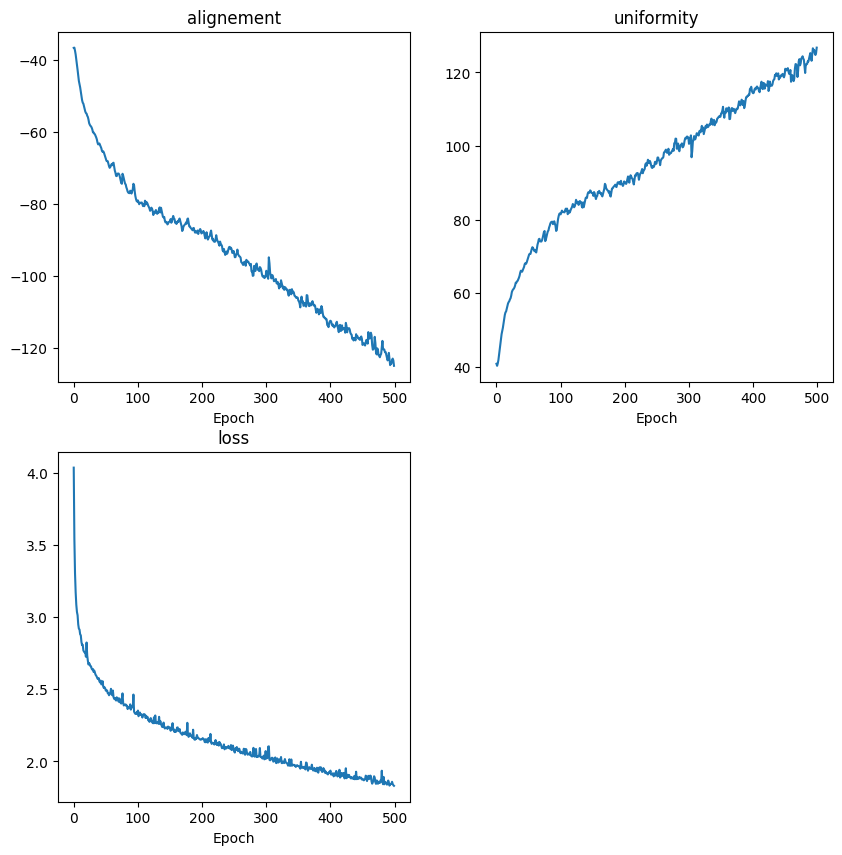

In [38]:
# Ottimizzatore
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

# Faccio il training e zottengo la storia di tutte le metriche
metrics = train_model(model, optimizer, dataloader, epochs=500)

# Plot risultati del training
plot_training_metrics(metrics)

Salvataggio modello

In [124]:
# import pickle as pkl
# with open('saved_models/InfoNCE_Mine_TrainTemperature_SameWeight.pkl','wb') as f:
#     pkl.dump(model, f)

Caricamento modello

In [19]:
# import pickle as pkl

# with open('saved_models/InfoNCE_Mine.pkl','rb') as f:
#     model = pkl.load(f)

In [20]:
model.eval()

z = np.zeros((0, latent_dim))
labels_cue = np.zeros(0)
labels_time = np.zeros(0)
labels_condition = np.zeros(0)

for i in range(0,dataset_pytorch.num_trials,512):
    x = dataset_pytorch.eeg_signals[i:i+512,:,:,:]
    l_cue = dataset_pytorch.labels['Cue'][i:i+512]
    l_time = dataset_pytorch.labels['Time'][i:i+512]
    l_condtion = dataset_pytorch.labels['Condition'][i:i+512]

    f_x = model.forward(x)  
    z = np.concatenate((z, f_x.cpu().detach().numpy()), axis=0)
    labels_cue = np.concatenate((labels_cue, l_cue.cpu().detach().numpy()))
    labels_time = np.concatenate((labels_time, l_time.cpu().detach().numpy()))
    labels_condition = np.concatenate((labels_condition, l_condtion.cpu().detach().numpy()))

from plots import plot_latents_3d

fig = plot_latents_3d(z, labels_cue, markersize=0.5, alpha=1, figsize=(7,7))
fig.show()

fig = plot_latents_3d(z, labels_condition, markersize=0.5, alpha=1, figsize=(7,7))
fig.show()

fig = plot_latents_3d(z, labels_time, discrete=False, show_legend=False, markersize=0.5, alpha=1, figsize=(7,7))
fig.show()




In [40]:
# Inizializzo il modello SVC
from sklearn.svm import SVC

model_svc = SVC()

# Fit del modello e calcolo accuratezza
model_svc.fit(z, labels_cue)
accuracy = model_svc.score(z, labels_cue)
print(f'Training accuracy for CUE = {accuracy*100:.2f}%')

model_svc.fit(z, labels_condition)
accuracy = model_svc.score(z, labels_condition)
print(f'Training accuracy for Condition = {accuracy*100:.2f}%')


Training accuracy for CUE = 69.88%
Training accuracy for Condition = 97.65%


In [101]:
# Scompongo in trial (non in finestre) e costruisco traiettorie di z per ognuno,
# colorate con la label del trial. Nel mio caso ci sono 125 finestre per trial
z_trials = []
label_trials = []

model.eval()

for i in range(270):
    ind_min = i * 125
    ind_max = (i+1) * 125

    x = dataset_pytorch.eeg_signals[ind_min:ind_max,:,:,:]
    z = model.forward(x)
    label = dataset_pytorch.labels['Cue'][ind_max-1]

    z_trials.append(z.detach().cpu().numpy())
    label_trials.append(label.cpu().numpy())



0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269


In [118]:
# Medie post-hoc
labels_unique = [0,1,2,3]
z_mean = []
label_trial_numpy = np.array(label_trials)

for i in range(4):
    z_this_label = [z_trials[j] for j in range(270) if label_trials[j] == i]
    z_stacked = np.stack(z_this_label, axis=-1)
    z_mean.append(z_stacked.mean(axis=2))
# print(z_mean)

In [125]:

plot_latent_trajectories_3d(z_mean, labels_unique, show_legend=True, figsize=(7,7), linewidth=2)

### Nota
La classe che si separa prima nello spazio latente (in viola) corrisponde allo stimolo "lingua"